<a href="https://colab.research.google.com/github/NiklasElsaesser/bug-free-fishstick/blob/main/Improved_Latent_Dirichlet_allocation_V3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Version 2 based on: [LDAPrototype](https://github.com/JonasRieger/ldaPrototype?tab=readme-ov-file)

In [ ]:
!pip install pandas
!pip install numpy
!pip install ldap
!pip install gensim
!pip install matplotlib wordcloud seaborn
!pip install pandas gensim scikit-learn numpy matplotlib seaborn
!pip install pyldavis


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


  Using cached ldap-2.0.0.404.tar.gz (2.0 kB)
  Preparing metadata (setup.py) ... done
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for ldap
  Running setup.py clean for ldap
Failed to build ldap
ERROR: ERROR: Failed to build installable wheels for some pyproject.toml based projects (ldap)


In [ ]:
import numpy as np
import pandas

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import pandas as pd
import gensim
from gensim import corpora
from gensim.models import CoherenceModel
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
import pandas as pd
import re
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **@Anna Datenbereinigung**:

In [ ]:
import json
import pandas as pd

# Load the dataset
dataset_path = "/content/drive/MyDrive/Effiziensteigerung/colab/News_Category_Dataset_v3.json"

with open(dataset_path, 'r') as file:
    news_data = [json.loads(line) for line in file]

# Convert to DataFrame for easy inspection
df = pd.DataFrame(news_data)

# Check the structure of the data
print(df.head())

# Example columns to expect: 'category', 'headline', 'short_description', 'link', 'authors', 'date'


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


                                                link  \
0  https://www.huffpost.com/entry/covid-boosters-...   
1  https://www.huffpost.com/entry/american-airlin...   
2  https://www.huffpost.com/entry/funniest-tweets...   
3  https://www.huffpost.com/entry/funniest-parent...   
4  https://www.huffpost.com/entry/amy-cooper-lose...   

                                            headline   category  \
0  Over 4 Million Americans Roll Up Sleeves For O...  U.S. NEWS   
1  American Airlines Flyer Charged, Banned For Li...  U.S. NEWS   
2  23 Of The Funniest Tweets About Cats And Dogs ...     COMEDY   
3  The Funniest Tweets From Parents This Week (Se...  PARENTING   
4  Woman Who Called Cops On Black Bird-Watcher Lo...  U.S. NEWS   

                                   short_description               authors  \
0  Health experts said it is too early to predict...  Carla K. Johnson, AP   
1  He was subdued by passengers and crew when he ...        Mary Papenfuss   
2  "Until you have a dog y

# **@Anna Datenbereinigung**:

In [ ]:
clean_df=df.drop(columns=['link','authors','date'])
clean_df.head(5)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,headline,category,short_description
0,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...
1,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...
2,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY,"""Until you have a dog you don't understand wha..."
3,The Funniest Tweets From Parents This Week (Se...,PARENTING,"""Accidentally put grown-up toothpaste on my to..."
4,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...


# **@Anna Datenbereinigung**:

In [ ]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
import string
import re

# Download necessary NLTK datasets
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

# Preprocessing function
def preprocess_text(text):
    # Lowercase the text
    text = text.lower()

    # Remove punctuation and non-alphabetical characters
    text = re.sub(r'[^\w\s]', '', text)

    # Tokenize
    tokens = word_tokenize(text)

    # Remove stopwords and lemmatize
    stop_words = set(stopwords.words('english'))
    lemmatizer = WordNetLemmatizer()

    tokens = [lemmatizer.lemmatize(word) for word in tokens if word not in stop_words]

    return tokens

# Apply preprocessing to the headlines and short descriptions
clean_df['processed_text'] = clean_df.apply(lambda row: preprocess_text(row['headline'] + ' ' + row['short_description']), axis=1)

# Filter out empty processed_text
processed_df = clean_df[clean_df['processed_text'].apply(len) > 0]

# Inspect the processed text
print(processed_df[['category', 'processed_text']].head())


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


    category                                     processed_text
0  U.S. NEWS  [4, million, american, roll, sleeve, omicronta...
1  U.S. NEWS  [american, airline, flyer, charged, banned, li...
2     COMEDY  [23, funniest, tweet, cat, dog, week, sept, 17...
3  PARENTING  [funniest, tweet, parent, week, sept, 1723, ac...
4  U.S. NEWS  [woman, called, cop, black, birdwatcher, loses...


In [ ]:
processed_df.head(5)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,headline,category,short_description,processed_text
0,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,"[4, million, american, roll, sleeve, omicronta..."
1,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,"[american, airline, flyer, charged, banned, li..."
2,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY,"""Until you have a dog you don't understand wha...","[23, funniest, tweet, cat, dog, week, sept, 17..."
3,The Funniest Tweets From Parents This Week (Se...,PARENTING,"""Accidentally put grown-up toothpaste on my to...","[funniest, tweet, parent, week, sept, 1723, ac..."
4,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,"[woman, called, cop, black, birdwatcher, loses..."


Step 1-4 are from LDAPrototype Paper

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

# 1. Remove all numbers from the processed_text column
processed_df['processed_text'] = processed_df['processed_text'].apply(lambda x: [word for word in x if not re.search(r'\d', word)])

# 2. Flatten processed_text for TF-IDF input
corpus = [" ".join(tokens) for tokens in processed_df['processed_text']]

# 3. Initialize TF-IDF Vectorizer
vectorizer = TfidfVectorizer(min_df=10)  # min_df removes terms that appear in fewer than 10 documents
tfidf_matrix = vectorizer.fit_transform(corpus)

# 4. Get feature names (words) and sort them by importance
feature_names = vectorizer.get_feature_names_out()

#Some very short words (e.g., one or two characters like "a", "is", etc.) may still remain despite removing stopwords, which might not be very informative.
processed_df['processed_text'] = processed_df['processed_text'].apply(lambda x: [word for word in x if len(word) > 2])


# Show the modified DataFrame
print(processed_df.head())

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-61-6f2c35f16e98>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  processed_df['processed_text'] = processed_df['processed_text'].apply(lambda x: [word for word in x if not re.search(r'\d', word)])


                                            headline   category  \
0  Over 4 Million Americans Roll Up Sleeves For O...  U.S. NEWS   
1  American Airlines Flyer Charged, Banned For Li...  U.S. NEWS   
2  23 Of The Funniest Tweets About Cats And Dogs ...     COMEDY   
3  The Funniest Tweets From Parents This Week (Se...  PARENTING   
4  Woman Who Called Cops On Black Bird-Watcher Lo...  U.S. NEWS   

                                   short_description  \
0  Health experts said it is too early to predict...   
1  He was subdued by passengers and crew when he ...   
2  "Until you have a dog you don't understand wha...   
3  "Accidentally put grown-up toothpaste on my to...   
4  Amy Cooper accused investment firm Franklin Te...   

                                      processed_text  
0  [million, american, roll, sleeve, omicrontarge...  
1  [american, airline, flyer, charged, banned, li...  
2  [funniest, tweet, cat, dog, week, sept, dog, d...  
3  [funniest, tweet, parent, week, sept,

<ipython-input-61-6f2c35f16e98>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  processed_df['processed_text'] = processed_df['processed_text'].apply(lambda x: [word for word in x if len(word) > 2])


In [ ]:
processed_df.head(5)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,headline,category,short_description,processed_text
0,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,"[million, american, roll, sleeve, omicrontarge..."
1,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,"[american, airline, flyer, charged, banned, li..."
2,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY,"""Until you have a dog you don't understand wha...","[funniest, tweet, cat, dog, week, sept, dog, d..."
3,The Funniest Tweets From Parents This Week (Se...,PARENTING,"""Accidentally put grown-up toothpaste on my to...","[funniest, tweet, parent, week, sept, accident..."
4,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,"[woman, called, cop, black, birdwatcher, loses..."


# **@Anna Daten vorbereitung für LDA**:

In [ ]:
# Create a Gensim dictionary from the 'preprocessed_text' column
dictionary = corpora.Dictionary(processed_df['processed_text'])

# Filter out extremes to limit the number of features
dictionary.filter_extremes(no_below=2, no_above=0.5)

# Convert tokenized documents into a Bag of Words (BOW) format
corpus = [dictionary.doc2bow(text) for text in processed_df['processed_text']]


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
print(corpus)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[[(0, 1), (1, 2), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (7, 1), (8, 1), (9, 1), (10, 2), (11, 1), (12, 1), (13, 1), (14, 1), (15, 1), (16, 1), (17, 1), (18, 1)], [(0, 1), (19, 1), (20, 1), (21, 1), (22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (32, 1), (33, 1), (34, 1), (35, 1), (36, 1), (37, 1), (38, 1), (39, 1)], [(40, 1), (41, 1), (42, 2), (43, 1), (44, 1), (45, 1), (46, 1), (47, 1), (48, 1), (49, 1)], [(45, 1), (46, 1), (47, 1), (49, 1), (50, 1), (51, 1), (52, 1), (53, 1), (54, 1), (55, 1), (56, 1), (57, 1), (58, 1), (59, 1), (60, 1), (61, 1), (62, 1), (63, 1), (64, 1), (65, 1)], [(39, 1), (66, 1), (67, 1), (68, 1), (69, 1), (70, 1), (71, 1), (72, 1), (73, 1), (74, 1), (75, 1), (76, 1), (77, 1), (78, 1), (79, 1), (80, 1), (81, 1), (82, 1), (83, 1), (84, 1), (85, 1), (86, 1), (87, 1), (88, 1)], [(15, 1), (51, 1), (88, 1), (89, 1), (90, 1), (91, 1), (92, 1), (93, 1), (94, 1), (95, 2), (96, 1), (97, 2), (98, 1), (99, 1), (100, 1), (101, 1)

## LDA Ausführung - Singlecore
1. V0 10 topics, 4 runs, 15 passes - complete
2. V1 15 topics, 5 runs, 15 passes - complete
3. V2 30 topics, 10 runs, 20 passes - complete
4. V3 10 topics, 4 runs, 30 passes - complete
5. V4 30 topics, 10 runs, 30 passes - complete
6. V5 10 topics, 2 runs, 50 passes - complete
7. V6 num_topics=40, num_runs=15, passes=25 corpus[:1000] - complete
8. V7 num_topics=10, num_runs=40, passes=10 corpus large -

In [ ]:
import random
import time
import gensim

def run_multiple_ldas(corpus, dictionary, num_topics=10, num_runs=40, passes=10, random_state=None):
    lda_models = []
    for i in range(num_runs):
        seed = random.randint(1, 10000) if random_state is None else random_state + i

        start_time = time.time()  # Start the timer
        start_clock_time = time.strftime("%Y-%m-%d %H:%M:%S", time.localtime(start_time))  # Record start clock time

        lda = gensim.models.LdaModel(
            corpus=corpus,
            id2word=dictionary,
            num_topics=num_topics,
            random_state=seed,
            passes=passes,
            alpha='auto',
            eta='auto'
        )

        end_time = time.time()  # End the timer
        end_clock_time = time.strftime("%Y-%m-%d %H:%M:%S", time.localtime(end_time))  # Record end clock time
        duration = (end_time - start_time) / 60  # Calculate time taken in minutes

        print(f'Run {i+1}/{num_runs} started at {start_clock_time} and ended at {end_clock_time}')
        print(f'Run {i+1} completed in {duration:.2f} minutes')

        lda_models.append(lda)

    return lda_models

# Example of running 10 LDA models with 30 topics each
lda_models = run_multiple_ldas(corpus, dictionary, num_topics=10, num_runs=40, passes=10, random_state=42)

# test if model is working on small data corpus
#small_corpus = corpus[:1000]  # Use the first 1000 documents as a subset
#lda_models = run_multiple_ldas(small_corpus, dictionary, num_topics=10, num_runs=30, passes=25, random_state=42)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Run 1/30 started at 2024-10-08 15:30:28 and ended at 2024-10-08 15:30:56
Run 1 completed in 0.46 minutes
Run 2/30 started at 2024-10-08 15:30:56 and ended at 2024-10-08 15:31:12
Run 2 completed in 0.27 minutes
Run 3/30 started at 2024-10-08 15:31:12 and ended at 2024-10-08 15:31:29
Run 3 completed in 0.27 minutes
Run 4/30 started at 2024-10-08 15:31:29 and ended at 2024-10-08 15:31:47
Run 4 completed in 0.31 minutes
Run 5/30 started at 2024-10-08 15:31:47 and ended at 2024-10-08 15:32:05
Run 5 completed in 0.29 minutes
Run 6/30 started at 2024-10-08 15:32:05 and ended at 2024-10-08 15:32:21
Run 6 completed in 0.26 minutes
Run 7/30 started at 2024-10-08 15:32:21 and ended at 2024-10-08 15:32:37
Run 7 completed in 0.27 minutes
Run 8/30 started at 2024-10-08 15:32:37 and ended at 2024-10-08 15:32:53
Run 8 completed in 0.27 minutes
Run 9/30 started at 2024-10-08 15:32:53 and ended at 2024-10-08 15:33:09
Run 9 completed in 0.26 minutes
Run 10/30 started at 2024-10-08 15:33:09 and ended at 2

In [ ]:
def extract_topics(lda_models, num_words=10):
    all_topics = []
    for lda in lda_models:
        topics = lda.show_topics(num_topics=-1, num_words=num_words, formatted=False)
        all_topics.append(topics)
    return all_topics

all_topics = extract_topics(lda_models, num_words=10)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from scipy.spatial.distance import jensenshannon

def get_topic_vectors(lda_models, dictionary, num_words=100):
    # Create term-document matrix for all topics across all models
    topic_vectors = []
    for lda in lda_models:
        for t in range(lda.num_topics):
            topic = lda.get_topic_terms(t, topn=num_words)
            vec = np.zeros(len(dictionary))
            for term_id, weight in topic:
                vec[term_id] = weight
            topic_vectors.append(vec)
    return topic_vectors

def calculate_similarity_matrix(topic_vectors, similarity='jaccard'):
    # Convert topic_vectors to a NumPy array if it is not already
    topic_vectors = np.array(topic_vectors)

    if similarity == 'cosine':
        # Compute cosine similarity
        return cosine_similarity(topic_vectors)

    elif similarity == 'jaccard':
        # For Jaccard, binarize the vectors
        bin_vectors = (topic_vectors > 0).astype(int)
        intersection = np.dot(bin_vectors, bin_vectors.T)
        row_sums = bin_vectors.sum(axis=1)
        union = row_sums[:, None] + row_sums - intersection
        return intersection / union

    elif similarity == 'jsd':
        # Compute Jensen-Shannon divergence, note it returns distance, so we subtract from 1
        n = len(topic_vectors)
        js_matrix = np.zeros((n, n))
        for i in range(n):
            for j in range(n):
                js_matrix[i, j] = jensenshannon(topic_vectors[i], topic_vectors[j])
        return 1 - js_matrix

    else:
        raise ValueError(f"Unknown similarity measure: {similarity}")


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
from sklearn.cluster import AgglomerativeClustering
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Assuming the function get_topic_vectors and calculate_similarity_matrix are already defined

# 1. Generate topic vectors from LDA models
topic_vectors = get_topic_vectors(lda_models, dictionary, num_words=100)

# 2. Calculate cosine similarity matrix
cosine_sim_matrix = calculate_similarity_matrix(topic_vectors, similarity='cosine')

# 3. Perform clustering (Agglomerative Clustering in this example)
# Metric = 'precomputed' means we provide a distance matrix, so we use 1 - cosine_sim_matrix as distance
clustering_model_cosine = AgglomerativeClustering(n_clusters=5, metric='precomputed', linkage='average')
cluster_labels_cosine = clustering_model_cosine.fit_predict(1 - cosine_sim_matrix)

# 4. Define the function to select prototype topics from each cluster
def select_prototype_topics(all_topics, cluster_labels):
    prototypes = []
    for cluster in np.unique(cluster_labels):
        # Get indices of topics in the current cluster
        cluster_indices = np.where(cluster_labels == cluster)[0]

        # Select the prototype topic (you can define your own criteria, here we just pick the first topic)
        prototype_topic = all_topics[cluster_indices[0]]  # Modify this selection logic if needed
        prototypes.append(prototype_topic)

    return prototypes

# 5. Assuming `all_topics` is available (list of topics from LDA models)
prototype_topics_cosine = select_prototype_topics(topic_vectors, cluster_labels_cosine)

# 6. Now you have the prototypes for the cosine similarity clustering


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def assign_prototype_topics(lda_models, corpus, prototype_topics, dictionary):
    # Create a single LDA model from prototypes for assignment
    # Alternatively, compute similarity between document-topic distributions and prototypes
    # Here, we'll assign based on the highest topic probability across all models
    doc_topics = []
    for bow in corpus:
        topic_probs = []
        for lda in lda_models:
            probs = lda.get_document_topics(bow, minimum_probability=0)
            topic_probs.extend([prob for _, prob in probs])
        # Assign the topic with the highest probability
        if topic_probs:
            dominant_topic = np.argmax(topic_probs)
            doc_topics.append(dominant_topic)
        else:
            doc_topics.append(None)
    return doc_topics

# Use .loc to set the dominant_topic column to avoid the warning
processed_df.loc[:, 'dominant_topic'] = assign_prototype_topics(lda_models, corpus, prototype_topics_cosine, dictionary)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-73-e3c27f2fa05e>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  processed_df.loc[:, 'dominant_topic'] = assign_prototype_topics(lda_models, corpus, prototype_topics_cosine, dictionary)


In [ ]:
print(processed_df.columns)
print(processed_df.head())


Index(['headline', 'category', 'short_description', 'processed_text',
       'dominant_topic'],
      dtype='object')
                                            headline   category  \
0  Over 4 Million Americans Roll Up Sleeves For O...  U.S. NEWS   
1  American Airlines Flyer Charged, Banned For Li...  U.S. NEWS   
2  23 Of The Funniest Tweets About Cats And Dogs ...     COMEDY   
3  The Funniest Tweets From Parents This Week (Se...  PARENTING   
4  Woman Who Called Cops On Black Bird-Watcher Lo...  U.S. NEWS   

                                   short_description  \
0  Health experts said it is too early to predict...   
1  He was subdued by passengers and crew when he ...   
2  "Until you have a dog you don't understand wha...   
3  "Accidentally put grown-up toothpaste on my to...   
4  Amy Cooper accused investment firm Franklin Te...   

                                      processed_text  dominant_topic  
0  [million, american, roll, sleeve, omicrontarge...             236  


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def compute_coherence(lda_model, texts, dictionary, coherence='c_v'):
    coherence_model = CoherenceModel(model=lda_model, texts=texts, dictionary=dictionary, coherence=coherence)
    return coherence_model.get_coherence()

# Compute coherence for each LDA model
for i, lda in enumerate(lda_models):
    coherence = compute_coherence(lda, processed_df['processed_text'], dictionary)
    print(f'LDA Model {i+1} Coherence: {coherence:.4f}')


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


LDA Model 1 Coherence: 0.2961
LDA Model 2 Coherence: 0.3096
LDA Model 3 Coherence: 0.2848
LDA Model 4 Coherence: 0.2597
LDA Model 5 Coherence: 0.2924
LDA Model 6 Coherence: 0.3043
LDA Model 7 Coherence: 0.2937
LDA Model 8 Coherence: 0.2853
LDA Model 9 Coherence: 0.2773
LDA Model 10 Coherence: 0.3089
LDA Model 11 Coherence: 0.2905
LDA Model 12 Coherence: 0.2874
LDA Model 13 Coherence: 0.3002
LDA Model 14 Coherence: 0.2950
LDA Model 15 Coherence: 0.3114
LDA Model 16 Coherence: 0.2916
LDA Model 17 Coherence: 0.2975
LDA Model 18 Coherence: 0.3020
LDA Model 19 Coherence: 0.2903
LDA Model 20 Coherence: 0.2914
LDA Model 21 Coherence: 0.3259
LDA Model 22 Coherence: 0.2886
LDA Model 23 Coherence: 0.2863
LDA Model 24 Coherence: 0.3024
LDA Model 25 Coherence: 0.3213
LDA Model 26 Coherence: 0.3161
LDA Model 27 Coherence: 0.2850
LDA Model 28 Coherence: 0.3147
LDA Model 29 Coherence: 0.2970
LDA Model 30 Coherence: 0.2980


# visualization

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:1281: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(aggregator, agg_var)


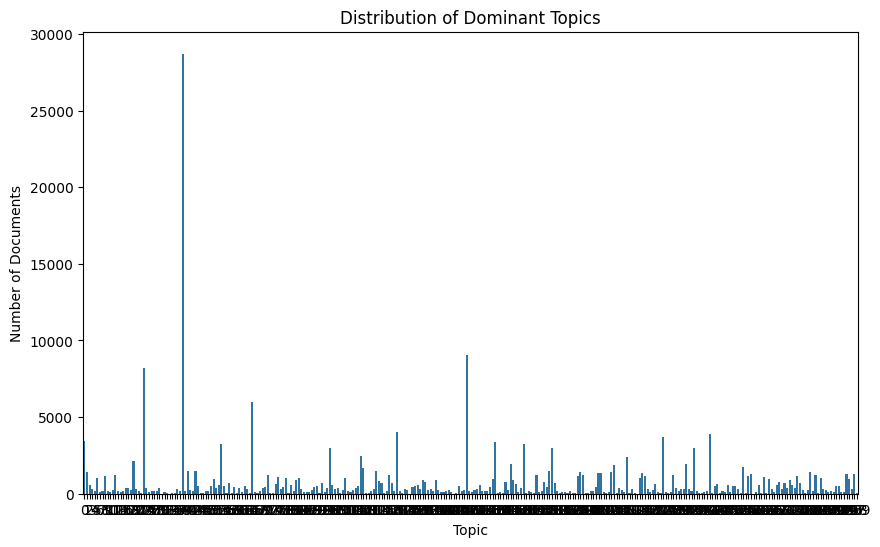

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the distribution of dominant topics
plt.figure(figsize=(10,6))
sns.countplot(x='dominant_topic', data=processed_df)
plt.title('Distribution of Dominant Topics')
plt.xlabel('Topic')
plt.ylabel('Number of Documents')
plt.show()


In [ ]:
!pip install pyldavis

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import pyLDAvis.gensim_models
import pyLDAvis

# Prepare visualization for the first LDA model
lda_visualization = pyLDAvis.gensim_models.prepare(lda_models[0], corpus, dictionary)
pyLDAvis.display(lda_visualization)

# Save the visualization to an HTML file in folder B:
pyLDAvis.save_html(lda_visualization, '/content/drive/MyDrive/Effiziensteigerung/LDA/V6_lda_visualization.html')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# Evaluating topics against values of category

In [ ]:
def get_top_words_per_topic(lda_model, num_words=10):
    top_words_per_topic = {}
    for topic_id in range(lda_model.num_topics):
        top_words = lda_model.show_topic(topic_id, topn=num_words)
        top_words_per_topic[topic_id] = [word for word, _ in top_words]
    return top_words_per_topic

# Get top words for the first LDA model as an example
top_words = get_top_words_per_topic(lda_models[0], num_words=10)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Define the function to assign dominant topics
def assign_dominant_topic(lda_model, corpus):
    dominant_topics = []
    for bow in corpus:
        topic_probs = lda_model.get_document_topics(bow, minimum_probability=0)
        dominant_topic = sorted(topic_probs, key=lambda x: x[1], reverse=True)[0][0]
        dominant_topics.append(dominant_topic)
    return dominant_topics

# Step to assign dominant topics
dominant_topics = assign_dominant_topic(lda_models[0], corpus)

# Use .loc to avoid SettingWithCopyWarning
processed_df.loc[:, 'dominant_topic'] = dominant_topics

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Checking the DataFrame after assigning dominant topics
print(processed_df.head())


                                            headline   category  \
0  Over 4 Million Americans Roll Up Sleeves For O...  U.S. NEWS   
1  American Airlines Flyer Charged, Banned For Li...  U.S. NEWS   
2  23 Of The Funniest Tweets About Cats And Dogs ...     COMEDY   
3  The Funniest Tweets From Parents This Week (Se...  PARENTING   
4  Woman Who Called Cops On Black Bird-Watcher Lo...  U.S. NEWS   

                                   short_description  \
0  Health experts said it is too early to predict...   
1  He was subdued by passengers and crew when he ...   
2  "Until you have a dog you don't understand wha...   
3  "Accidentally put grown-up toothpaste on my to...   
4  Amy Cooper accused investment firm Franklin Te...   

                                      processed_text  dominant_topic  
0  [million, american, roll, sleeve, omicrontarge...               9  
1  [american, airline, flyer, charged, banned, li...               6  
2  [funniest, tweet, cat, dog, week, sept, dog,

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def map_topics_to_categories(processed_df):
    topic_category_mapping = {}
    for topic in processed_df['dominant_topic'].unique():
        # Get documents assigned to the topic
        topic_docs = processed_df[processed_df['dominant_topic'] == topic]
        # Find the most common category among these documents
        if not topic_docs.empty:
            most_common_category = topic_docs['category'].mode()[0]
            topic_category_mapping[topic] = most_common_category
    return topic_category_mapping

# Create the mapping
topic_category_mapping = map_topics_to_categories(processed_df)
print("Topic to Category Mapping:")
print(topic_category_mapping)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Topic to Category Mapping:
{9: 'POLITICS', 6: 'WELLNESS', 0: 'POLITICS', 4: 'ENTERTAINMENT', 5: 'POLITICS', 2: 'POLITICS', 7: 'POLITICS', 1: 'POLITICS', 8: 'POLITICS', 3: 'POLITICS'}


In [ ]:
def assign_predicted_category(processed_df, topic_category_mapping):
    processed_df['predicted_category'] = processed_df['dominant_topic'].map(topic_category_mapping)
    return processed_df

# Assign predicted categories
processed_df = assign_predicted_category(processed_df, topic_category_mapping)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-83-dd7b0474e2bc>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  processed_df['predicted_category'] = processed_df['dominant_topic'].map(topic_category_mapping)


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

# Remove any rows where 'predicted_category' is NaN
evaluation_df = processed_df.dropna(subset=['predicted_category'])

# Actual and predicted categories
y_true = evaluation_df['category']
y_pred = evaluation_df['predicted_category']

# Calculate metrics
print("Classification Report:")
print(classification_report(y_true, y_pred))

print("Confusion Matrix:")
print(confusion_matrix(y_true, y_pred))

print(f"Accuracy Score: {accuracy_score(y_true, y_pred):.4f}")


Classification Report:


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/

                precision    recall  f1-score   support

          ARTS       0.00      0.00      0.00      1509
ARTS & CULTURE       0.00      0.00      0.00      1339
  BLACK VOICES       0.00      0.00      0.00      4583
      BUSINESS       0.00      0.00      0.00      5991
       COLLEGE       0.00      0.00      0.00      1144
        COMEDY       0.00      0.00      0.00      5398
         CRIME       0.00      0.00      0.00      3562
CULTURE & ARTS       0.00      0.00      0.00      1074
       DIVORCE       0.00      0.00      0.00      3426
     EDUCATION       0.00      0.00      0.00      1014
 ENTERTAINMENT       0.11      0.07      0.09     17361
   ENVIRONMENT       0.00      0.00      0.00      1444
         FIFTY       0.00      0.00      0.00      1400
  FOOD & DRINK       0.00      0.00      0.00      6340
     GOOD NEWS       0.00      0.00      0.00      1398
         GREEN       0.00      0.00      0.00      2622
HEALTHY LIVING       0.00      0.00      0.00  

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


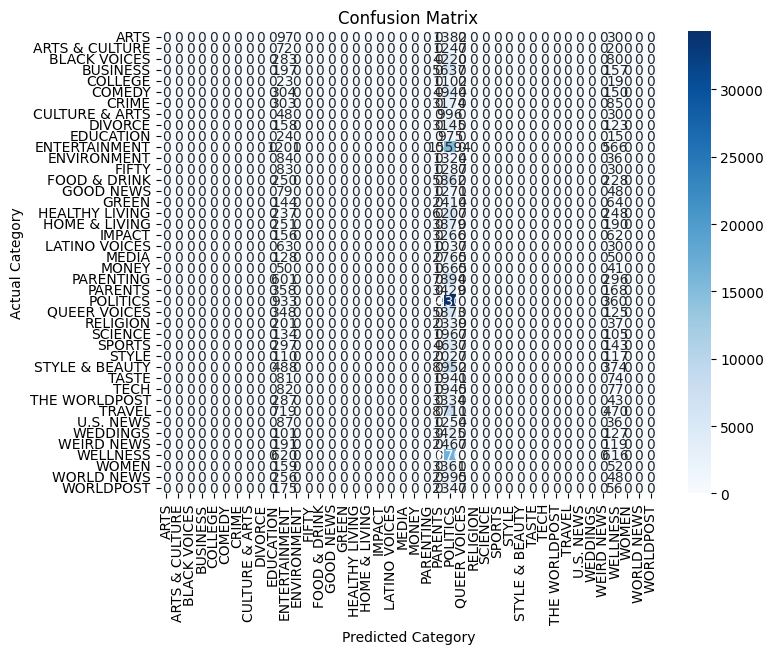

In [ ]:
import seaborn as sns

def plot_confusion_matrix(y_true, y_pred, labels):
    cm = confusion_matrix(y_true, y_pred, labels=labels)
    plt.figure(figsize=(8,6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=labels, yticklabels=labels)
    plt.ylabel('Actual Category')
    plt.xlabel('Predicted Category')
    plt.title('Confusion Matrix')
    plt.show()

# Get list of unique categories
categories = sorted(processed_df['category'].unique())

# Plot confusion matrix
plot_confusion_matrix(y_true, y_pred, labels=categories)


# further visualization

In [ ]:
processed_df.head(5)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,headline,category,short_description,processed_text,dominant_topic,predicted_category
0,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,"[million, american, roll, sleeve, omicrontarge...",9,POLITICS
1,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,"[american, airline, flyer, charged, banned, li...",6,WELLNESS
2,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY,"""Until you have a dog you don't understand wha...","[funniest, tweet, cat, dog, week, sept, dog, d...",0,POLITICS
3,The Funniest Tweets From Parents This Week (Se...,PARENTING,"""Accidentally put grown-up toothpaste on my to...","[funniest, tweet, parent, week, sept, accident...",4,ENTERTAINMENT
4,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,"[woman, called, cop, black, birdwatcher, loses...",5,POLITICS


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.table import Table

# Assuming 'processed_df' already contains 'headline', 'category', and 'dominant_topic'

# Add a column for the top words of the dominant topic for each document
def get_top_words_for_topic(lda_model, topic_id, num_words=5):
    return ", ".join([word for word, _ in lda_model.show_topic(topic_id, topn=num_words)])

# Add the top words for the dominant topic to the dataframe
processed_df['generated_topic'] = processed_df['dominant_topic'].apply(
    lambda topic_id: get_top_words_for_topic(lda_models[0], topic_id, num_words=5)
)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-87-8820664eb46e>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  processed_df['generated_topic'] = processed_df['dominant_topic'].apply(


In [ ]:
# Select columns for display
df_visual = processed_df[['headline', 'short_description', 'category', 'predicted_category']]

# Display a simple DataFrame table
df_visual.head(20)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,headline,short_description,category,predicted_category
0,Over 4 Million Americans Roll Up Sleeves For O...,Health experts said it is too early to predict...,U.S. NEWS,POLITICS
1,"American Airlines Flyer Charged, Banned For Li...",He was subdued by passengers and crew when he ...,U.S. NEWS,WELLNESS
2,23 Of The Funniest Tweets About Cats And Dogs ...,"""Until you have a dog you don't understand wha...",COMEDY,POLITICS
3,The Funniest Tweets From Parents This Week (Se...,"""Accidentally put grown-up toothpaste on my to...",PARENTING,ENTERTAINMENT
4,Woman Who Called Cops On Black Bird-Watcher Lo...,Amy Cooper accused investment firm Franklin Te...,U.S. NEWS,POLITICS
5,Cleaner Was Dead In Belk Bathroom For 4 Days B...,The 63-year-old woman was seen working at the ...,U.S. NEWS,POLITICS
6,Reporter Gets Adorable Surprise From Her Boyfr...,"""Who's that behind you?"" an anchor for New Yor...",U.S. NEWS,POLITICS
7,Puerto Ricans Desperate For Water After Hurric...,More than half a million people remained witho...,WORLD NEWS,POLITICS
8,How A New Documentary Captures The Complexity ...,"In ""Mija,"" director Isabel Castro combined mus...",CULTURE & ARTS,POLITICS
9,Biden At UN To Call Russian War An Affront To ...,White House officials say the crux of the pres...,WORLD NEWS,POLITICS


In [ ]:
df_visual.to_csv('/content/drive/MyDrive/Effiziensteigerung/colab/V6_headline_category_generated_topic.csv', index=False)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
